<a href="https://colab.research.google.com/github/Minh-A/Dacon/blob/main/Dacon_LSTM_Beta4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 레츠 기릿 (0306)
> 모델에 relu를 추가

In [ ]:
# 파이토치 라이브러리 임포트
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings(action='ignore')
import torch
import torch.nn as nn
import torch.nn.functional as F

import torchvision
import torchvision.transforms as transforms
from torch.utils.data import Dataset,DataLoader, TensorDataset
from torch.autograd import Variable  # 자동미분기능 제공
import torch.optim as optim
import matplotlib.pyplot as plt

from tqdm import tqdm  # 진행표시바

# np.random.seed(777)
# torch.manual_seed(777)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")  # GPU, CPU 선택
print('CPU? GPU? : ', device)

In [ ]:
# 구글드라이브 연결
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
fn = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/data/train.csv')
fn

데이터 생성

In [ ]:
# 이거는 데이터명만
# 첫 번째 파일은 제하고
dm = fn.iloc[423:,1]
dm.shape

(59,)

In [ ]:
# 데이터 확인
data = np.load('/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/data/train/201401.npy')

In [ ]:
data[:,150,0]

array([  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   6,  28,  50,  12,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0, 177, 162,
       165, 187,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0, 234, 230,
       231, 233, 234, 236, 236, 237, 237, 237, 238, 240, 240, 243,   0,
         0,   0,   0,   0,   0, 232, 240, 246, 247, 247, 247, 24

In [ ]:
# 데이터 생성
data = np.load('/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/data/train/201401.npy')
data = data.reshape(1,448,304,5)

for i in tqdm(dm):
    a = np.load('/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/data/train/'+i)
    a = a.reshape(1,448,304,5)

    data = np.concatenate((data,a), axis=0)
data = np.array(data)
data = data[:,:,:,0]

data.shape

100%|██████████| 59/59 [00:20<00:00,  2.85it/s]


(60, 448, 304)

그냥

In [ ]:
data.shape[0]

60

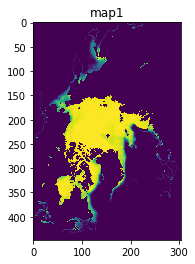

In [ ]:
# 그래프 그려보기
import matplotlib.pyplot
matplotlib.pyplot.imshow(data[0], interpolation = 'None')
matplotlib.pyplot.title('map1')
matplotlib.pyplot.show()

그냥 끝

In [ ]:
# 그래프 함수
def show(npy):
    num_channel = npy.shape[0]
    plt.figure(figsize=(50, 50)) 
    for channel in range(num_channel):
      tmpimg = npy[channel, :, :]
      ax = plt.subplot(1, num_channel, channel+1)  # (행, 열, 데이터 개수) - 그리고 싶은 팜플렛
      ax.title.set_text("Ice")

      ax.imshow(tmpimg)
    plt.tight_layout()
    plt.show()
    plt.close()

In [ ]:
show(data[:12])
show(data[12:24])
show(data[24:36])
show(data[36:48])
show(data[48:60])

In [ ]:
# 데이터 셋 만들기

# 데이터 셋 형태 변환
data = data.reshape(60,1, 448,304)

# 월별로 데이터 셋 생성
for i in tqdm(range(12)):
  globals()['train{}'.format(i)] = np.array(np.concatenate((data[0+i], data[12+i], data[24+i], data[36+i], data[48+i]), axis=0))

  print("\n",globals()['train{}'.format(i)].shape)  # globals()는 그 변수를 의미 - 없으면 그냥 문자열

100%|██████████| 12/12 [00:00<00:00, 795.34it/s]


 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)


월별로 5개씩(5년)

총 12개의 데이터 (12개월)

In [ ]:
# 월별 데이터 확인
for i in range(12):
  d = globals()['train{}'.format(i)]
  show(d)

In [ ]:
train0[:4].shape

(4, 448, 304)

In [ ]:
train0[4].reshape(1,448,304).shape

(1, 448, 304)

In [ ]:
# Model 생성
import torch
import torch.nn as nn
import torch.nn.functional as F

class LSTM(nn.Module):
    def __init__(self, input_size, hidden_size):
        super(LSTM, self).__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size

        self.lstm = nn.LSTM(input_size = hidden_size,
                            hidden_size = hidden_size,
                            batch_first=True,
                            num_layers = 1)
        self.relu = nn.ReLU(inplace = True)
        self.time_fc = nn.Linear(hidden_size, 304)
        
        self.f1 = nn.Linear(input_size, hidden_size)

    def forward(self, x_time):
        out_time = self.f1(x_time)
        out_time, _ = self.lstm(x_time)
        out_time = self.relu(out_time)
        out_time = self.time_fc(out_time[-1:,:,:])  # 나오는 수 아웃풋
        out_time = self.relu(out_time[-1:,:,:])
        
        return out_time.view(1,448,304)  # -1은 전체 나와라

# model = LSTM(input_size = 304, hidden_size = 304).to(device)

In [ ]:
# 데이터 셋
window_x = torch.tensor(train0[:4]).float().to(device)  # 데이터를 GPU로
window_y = torch.tensor(train0[4].reshape(1,448,304)).float().to(device)

In [ ]:
window_x.shape, window_y.shape

(torch.Size([4, 448, 304]), torch.Size([1, 448, 304]))

In [ ]:
# 함수

def aaa(number):

  a = globals()['train{}'.format(number)]
  
  print('train{}'.format(number))

  # 데이터 셋
  window_x = torch.tensor(a[:4]).float().to(device)  # 데이터를 GPU로  
  window_y = torch.tensor(a[4].reshape(1,448,304)).float().to(device)

  # 모델
  model_0 = LSTM(input_size = 304, hidden_size = 304).to(device)
  
  optimizer = torch.optim.Adam(model_0.parameters(), lr = 0.5)  
  criterion = nn.MSELoss()
  num_epochs  = 1500
  train_error = []

  for t in range(num_epochs):
    train_pred = model_0(window_x)
    loss = criterion(train_pred, window_y)  
    train_error.append(loss)
    
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    if (t +1) % 300 == 0:
      print((t +1), "Epochs train MSE: ", loss.item())  

  # 예측
  a = model_0(window_y)
  pred = a.cpu().detach().numpy().reshape(448,304)
  
  globals()['a{}'.format(number)] = pred


In [ ]:
for i in range(12):
  aaa(i)

train0
300 Epochs train MSE:  645.6771850585938
600 Epochs train MSE:  511.0276184082031
900 Epochs train MSE:  457.9042663574219
1200 Epochs train MSE:  428.2212829589844
1500 Epochs train MSE:  408.3024597167969
train1
300 Epochs train MSE:  1108.5472412109375
600 Epochs train MSE:  949.2733764648438
900 Epochs train MSE:  880.7802734375
1200 Epochs train MSE:  845.729248046875
1500 Epochs train MSE:  811.18017578125
train2
300 Epochs train MSE:  753.6047973632812
600 Epochs train MSE:  598.4467163085938
900 Epochs train MSE:  546.2383422851562
1200 Epochs train MSE:  511.7537841796875
1500 Epochs train MSE:  487.8102111816406
train3
300 Epochs train MSE:  869.2438354492188
600 Epochs train MSE:  719.8350219726562
900 Epochs train MSE:  660.9520874023438
1200 Epochs train MSE:  629.3842163085938
1500 Epochs train MSE:  651.5919189453125
train4
300 Epochs train MSE:  722.0426635742188
600 Epochs train MSE:  560.7816772460938
900 Epochs train MSE:  518.9932861328125
1200 Epochs train M

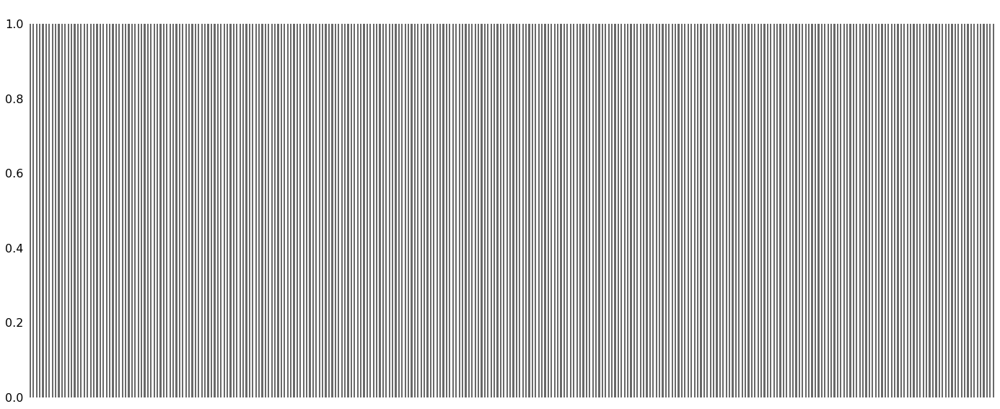

In [ ]:
import missingno as msno
msno.bar(pd.DataFrame(train8[2]))
# pd.DataFrame(train5[2]).isna().sum()

In [ ]:
pd.DataFrame(train8[4]).isnull().sum().sum()

0

In [ ]:
window_x = torch.tensor(train8[:4]).float().to(device)  # 데이터를 GPU로  
window_y = torch.tensor(train8[4].reshape(1,448,304)).float().to(device)
model_0(window_x)

tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]], device='cuda:0',
       grad_fn=<ViewBackward>)

In [ ]:
model_0(window_x).shape

torch.Size([1, 448, 304])

In [ ]:
pd.DataFrame(window_y).isnull().sum().sum()

0

In [ ]:
window_y.shape

torch.Size([1, 448, 304])

In [ ]:
criterion(model_0(window_x), window_y)  

tensor(1146.4137, device='cuda:0', grad_fn=<MseLossBackward>)

In [ ]:
d = pd.DataFrame(train8[0])
d.iloc[(d.isna() == True),:]

ValueError: ignored

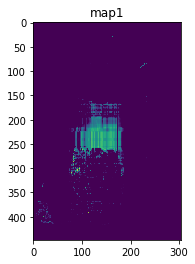

In [ ]:
# 그래프 그려보기
import matplotlib.pyplot
matplotlib.pyplot.imshow(a8, interpolation = 'None')
matplotlib.pyplot.title('map1')
matplotlib.pyplot.show()

In [ ]:
for i in range(12):
  print('a{}'.format(i))
  sh = globals()['a{}'.format(i)]
  print(sh.shape)

a0
(448, 304)
a1
(448, 304)
a2
(448, 304)
a3
(448, 304)
a4
(448, 304)
a5
(448, 304)
a6
(448, 304)
a7
(448, 304)
a8
(448, 304)
a9
(448, 304)
a10
(448, 304)
a11
(448, 304)


In [ ]:
a00 = a0.flatten()
a11 = a1.flatten()

In [ ]:
pd.concat((pd.DataFrame(a00), pd.DataFrame(a11)), axis=1).T

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,136152,136153,136154,136155,136156,136157,136158,136159,136160,136161,136162,136163,136164,136165,136166,136167,136168,136169,136170,136171,136172,136173,136174,136175,136176,136177,136178,136179,136180,136181,136182,136183,136184,136185,136186,136187,136188,136189,136190,136191
0,-0.300364,-0.469871,-2.143445,-0.515727,0.388646,-0.057219,-0.344755,-2.469652,-1.547591,-1.336731,-1.454313,-2.133392,-4.067870,-1.292614,-1.945988,0.228403,-0.918704,-1.228467,1.508693,1.320930,-4.475691,-3.897219,-3.467510,-1.570797,1.176086,0.126717,2.669886,4.065519,2.414455,-0.463134,-0.955287,-5.815211,-1.112633,-7.748525,-8.153834,-6.249945,-10.069598,-1.880501,-7.049236,-10.593591,...,-2.133783,-1.834732,-1.299625,-0.610541,-0.058325,-0.935063,-1.75778,-1.855718,-1.153989,-0.373968,-0.527775,-0.835108,-1.063236,-1.809215,-0.970658,-2.216591,-0.618166,0.952541,0.655663,1.509399,0.462717,-1.427857,-1.060632,-0.712059,-1.035424,-1.401209,-1.590456,0.610840,-0.939752,-1.031353,-1.047871,-1.121787,0.223013,-0.697139,0.332771,1.397938,-0.668162,-0.844768,0.560319,0.470689
0,0.068617,0.155661,-0.095869,0.239940,-1.847064,-0.956334,-0.374925,-0.738875,-0.639984,-0.614767,-0.175980,0.626868,3.377809,3.699929,4.338602,3.647567,6.894026,5.003918,4.516331,3.446965,7.549632,-3.514473,-1.024254,2.992162,3.933247,1.418562,1.261543,-2.930445,-5.458613,-2.514471,-0.822299,1.970531,1.724662,-2.557098,-1.843138,-3.412107,-4.921885,1.389740,0.217113,-0.070384,...,-7.253574,-5.662739,-10.283263,-10.932906,-1.835991,-0.580535,-1.54737,-2.580401,-3.713209,-4.164331,-5.813921,-3.454281,-4.091017,-0.443848,3.839122,8.453660,3.805371,8.075843,3.258349,-4.009621,-0.143315,-2.685625,-5.467536,-1.808994,2.440796,-2.395844,-2.164334,-4.459301,-2.587236,-0.686754,-2.733178,-5.733824,-4.589310,-2.444708,0.172628,-3.323351,2.530367,-3.032949,-1.955844,1.500200


In [ ]:
# 데이터 생성
sh1 = pd.DataFrame(a0.flatten())

for i in range(11):
  print('a{}'.format(i+1))
  sh = globals()['a{}'.format(i+1)]
  sh = sh.flatten()
  sh = pd.DataFrame(sh)

  sh1 = pd.concat((sh1, sh), axis=1)
  print(sh1.shape)

a1
(136192, 2)
a2
(136192, 3)
a3
(136192, 4)
a4
(136192, 5)
a5
(136192, 6)
a6
(136192, 7)
a7
(136192, 8)
a8
(136192, 9)
a9
(136192, 10)
a10
(136192, 11)
a11
(136192, 12)


In [ ]:
result = sh1.T
result = result.reset_index(drop=True)
result

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,136152,136153,136154,136155,136156,136157,136158,136159,136160,136161,136162,136163,136164,136165,136166,136167,136168,136169,136170,136171,136172,136173,136174,136175,136176,136177,136178,136179,136180,136181,136182,136183,136184,136185,136186,136187,136188,136189,136190,136191
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.640341,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
# 사실 필요 없움
# 두번 해야..
# 12개월, 24개월 투투
result1 = pd.concat([result,result], axis=0)
result1 = result1.reset_index(drop=True)

In [ ]:
submission = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/data/sample_submission.csv")
sub = pd.concat([submission.loc[:,'month'],result1], axis=1)
sub.columns = submission.columns.values  # 제출파일에서 컬럼명을 
sub.tail()

,month,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,...,136152,136153,136154,136155,136156,136157,136158,136159,136160,136161,136162,136163,136164,136165,136166,136167,136168,136169,136170,136171,136172,136173,136174,136175,136176,136177,136178,136179,136180,136181,136182,136183,136184,136185,136186,136187,136188,136189,136190,136191
19,2020-08,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
20,2020-09,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
21,2020-10,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
22,2020-11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
23,2020-12,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
# 제출
sub.to_csv('/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/result/sub_0306-1.csv', index = False)

-----

일단 여기서 제출!!!

In [ ]:
data[0, 0,:,150]

array([  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   6,  28,  50,  12,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0, 177, 162,
       165, 187,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0, 234, 230,
       231, 233, 234, 236, 236, 237, 237, 237, 238, 240, 240, 243,   0,
         0,   0,   0,   0,   0, 232, 240, 246, 247, 247, 247, 24

In [ ]:
data.shape

(60, 1, 448, 304)

In [ ]:
model_0(window_x)[0,:,150]

tensor([0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 3.4313e-01, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 1.6759e+01, 5.7110e+

In [ ]:
window_x.shape

torch.Size([4, 448, 304])

In [ ]:
model_0 = LSTM(input_size = 304, hidden_size = 304).to(device)
model_0(window_x)

tensor([[[0.0000, 0.0268, 0.0632,  ..., 0.0000, 0.0806, 0.0000],
         [0.0000, 0.0616, 0.0921,  ..., 0.0000, 0.1479, 0.0000],
         [0.0000, 0.0693, 0.0000,  ..., 0.0000, 0.1451, 0.0000],
         ...,
         [0.0000, 0.0640, 0.0000,  ..., 0.0000, 0.0000, 0.0351],
         [0.0000, 0.0641, 0.0000,  ..., 0.0000, 0.0000, 0.0351],
         [0.0000, 0.0641, 0.0000,  ..., 0.0000, 0.0000, 0.0350]]],
       device='cuda:0', grad_fn=<ViewBackward>)

In [ ]:
model_0(window_x).shape

torch.Size([1, 448, 304])

In [ ]:
# Model 생성
import torch
import torch.nn as nn
import torch.nn.functional as F

class LSTM(nn.Module):
    def __init__(self, input_size, hidden_size):
        super(LSTM, self).__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size

        self.lstm = nn.LSTM(input_size = input_size,
                            hidden_size = hidden_size,
                            batch_first=True,
                            num_layers = 1)
        self.time_fc = nn.Linear(hidden_size, 304)
        self.relu = nn.ReLU(inplace = True)
        
        self.f1 = nn.Linear(input_size, hidden_size)

    def forward(self, x_time):
        # out_time = self.f1(x_time)
        out_time, _ = self.lstm(x_time)
        out_time = self.time_fc(out_time[-1:,:,:])  # 나오는 수 아웃풋
        out_time = self.relu(out_time[-1:,:,:])
        
        return out_time.view(1,448,304)  # -1은 전체 나와라

# model = LSTM(input_size = 304, hidden_size = 304).to(device)

In [ ]:
# 가장 완벽한 러닝 레이트를 찾아
from random import *
a = [0.5, 0.1, 0.01, 0.001, 0.0001]

for i in range(len(a)):
  lr = a[i]
  print("\n",a[i])
  model_0 = LSTM(input_size = 304, hidden_size = 304).to(device)
  
  optimizer = torch.optim.Adam(model_0.parameters(), lr = lr)  
  criterion = nn.MSELoss()
  num_epochs  = 1500
  train_error = []

  for t in range(num_epochs):
    train_pred = model_0(window_x)
    loss = criterion(train_pred, window_y)  
    train_error.append(loss)
    
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    if (t +1) % 100 == 0:
      print((t +1), "Epochs train MSE: ", loss.item())


 5
100 Epochs train MSE:  7175.08154296875
200 Epochs train MSE:  7161.91650390625
300 Epochs train MSE:  7151.06298828125
400 Epochs train MSE:  7145.89794921875
500 Epochs train MSE:  7145.48291015625
600 Epochs train MSE:  7144.20751953125
700 Epochs train MSE:  7146.26904296875
800 Epochs train MSE:  7143.84716796875
900 Epochs train MSE:  7141.65380859375
1000 Epochs train MSE:  7141.74951171875
1100 Epochs train MSE:  7141.421875
1200 Epochs train MSE:  7138.82568359375
1300 Epochs train MSE:  7147.630859375
1400 Epochs train MSE:  7142.16455078125
1500 Epochs train MSE:  7140.61181640625

 0.5
100 Epochs train MSE:  1090.2991943359375
200 Epochs train MSE:  834.6990356445312
300 Epochs train MSE:  694.763671875
400 Epochs train MSE:  606.3894653320312
500 Epochs train MSE:  557.33154296875
600 Epochs train MSE:  525.4708251953125
700 Epochs train MSE:  502.41131591796875
800 Epochs train MSE:  484.6023864746094
900 Epochs train MSE:  470.242431640625
1000 Epochs train MSE:  459

KeyboardInterrupt: ignored

# 모델을 조금 바꾸어서 (0306-1)
> 흠흠 개선점은  월별로 다르게 러닝레이트와 모델을 주삼

* 해당 모델의 결론임

In [ ]:
# 파이토치 라이브러리 임포트
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings(action='ignore')
import torch
import torch.nn as nn
import torch.nn.functional as F

import torchvision
import torchvision.transforms as transforms
from torch.utils.data import Dataset,DataLoader, TensorDataset
from torch.autograd import Variable  # 자동미분기능 제공
import torch.optim as optim
import matplotlib.pyplot as plt

from tqdm import tqdm  # 진행표시바

# np.random.seed(777)
# torch.manual_seed(777)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")  # GPU, CPU 선택
print('CPU? GPU? : ', device)

CPU? GPU? :  cuda:0


In [ ]:
# 구글드라이브 연결
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
fn = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/data/train.csv')
fn

,month,file_nm
0,1978-11,197811.npy
1,1978-12,197812.npy
2,1979-01,197901.npy
3,1979-02,197902.npy
4,1979-03,197903.npy
...,...,...
477,2018-08,201808.npy
478,2018-09,201809.npy
479,2018-10,201810.npy
480,2018-11,201811.npy


데이터 생성

In [ ]:
# 이거는 데이터명만
# 첫 번째 파일은 제하고
dm = fn.iloc[423:,1]
dm.shape

(59,)

In [ ]:
# 데이터 확인
data = np.load('/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/data/train/201401.npy')

In [ ]:
data[:,150,0]

array([  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   6,  28,  50,  12,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0, 177, 162,
       165, 187,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0, 234, 230,
       231, 233, 234, 236, 236, 237, 237, 237, 238, 240, 240, 243,   0,
         0,   0,   0,   0,   0, 232, 240, 246, 247, 247, 247, 24

In [ ]:
# 데이터 생성
data = np.load('/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/data/train/201401.npy')
data = data.reshape(1,448,304,5)

for i in tqdm(dm):
    a = np.load('/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/data/train/'+i)
    a = a.reshape(1,448,304,5)

    data = np.concatenate((data,a), axis=0)
data = np.array(data)
data = data[:,:,:,0]

data.shape

100%|██████████| 59/59 [00:22<00:00,  2.61it/s]


(60, 448, 304)

그냥

In [ ]:
data.shape[0]

60

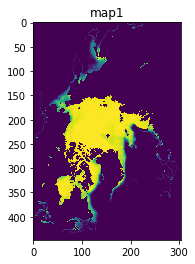

In [ ]:
# 그래프 그려보기
import matplotlib.pyplot
matplotlib.pyplot.imshow(data[0], interpolation = 'None')
matplotlib.pyplot.title('map1')
matplotlib.pyplot.show()

그냥 끝

In [ ]:
# 그래프 함수
def show(npy):
    num_channel = npy.shape[0]
    plt.figure(figsize=(50, 50)) 
    for channel in range(num_channel):
      tmpimg = npy[channel, :, :]
      ax = plt.subplot(1, num_channel, channel+1)  # (행, 열, 데이터 개수) - 그리고 싶은 팜플렛
      ax.title.set_text("Ice")

      ax.imshow(tmpimg)
    plt.tight_layout()
    plt.show()
    plt.close()

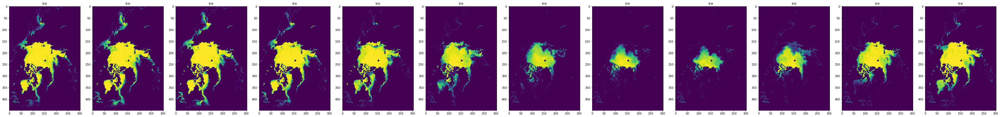

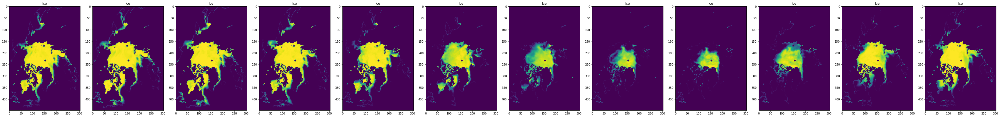

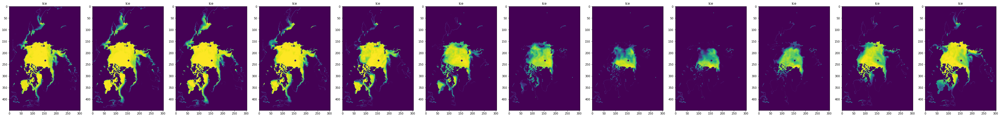

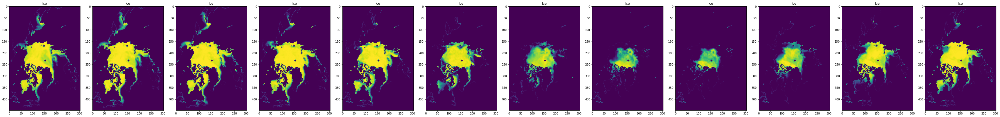

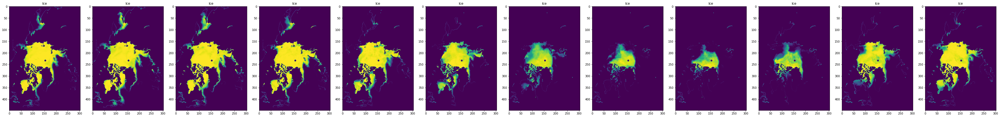

In [ ]:
show(data[:12])
show(data[12:24])
show(data[24:36])
show(data[36:48])
show(data[48:60])

In [ ]:
# 데이터 셋 만들기

# 데이터 셋 형태 변환
data = data.reshape(60,1, 448,304)

# 월별로 데이터 셋 생성
for i in tqdm(range(12)):
  globals()['train{}'.format(i)] = np.array(np.concatenate((data[0+i], data[12+i], data[24+i], data[36+i], data[48+i]), axis=0))

  print("\n",globals()['train{}'.format(i)].shape)  # globals()는 그 변수를 의미 - 없으면 그냥 문자열

100%|██████████| 12/12 [00:00<00:00, 743.80it/s]


 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)


월별로 5개씩(5년)

총 12개의 데이터 (12개월)

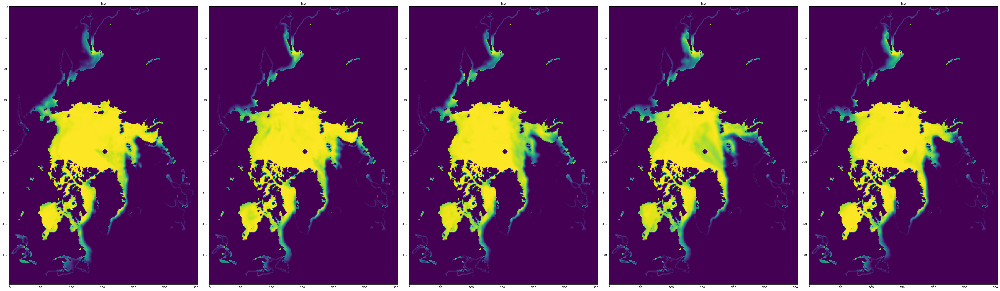

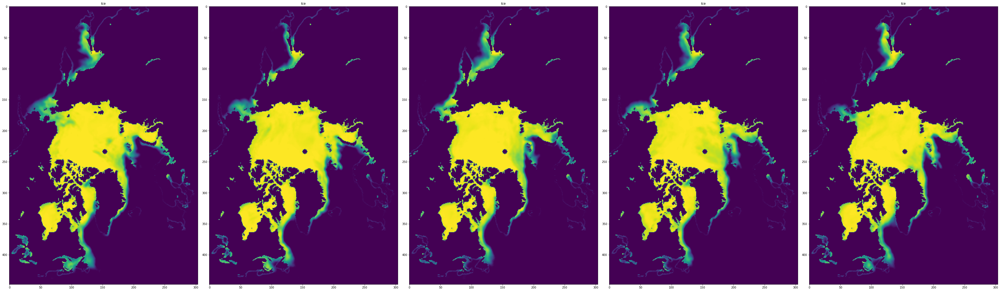

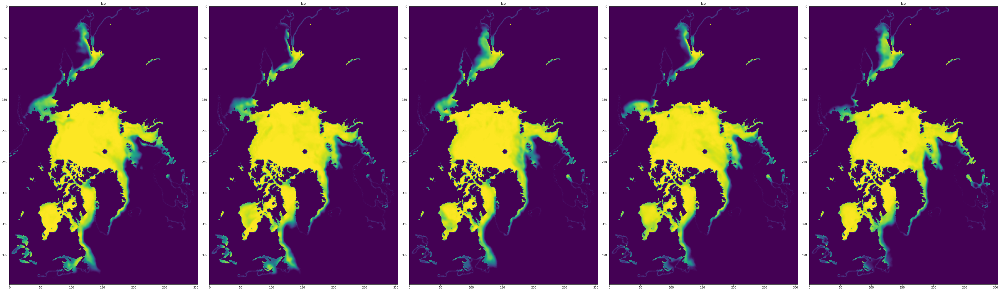

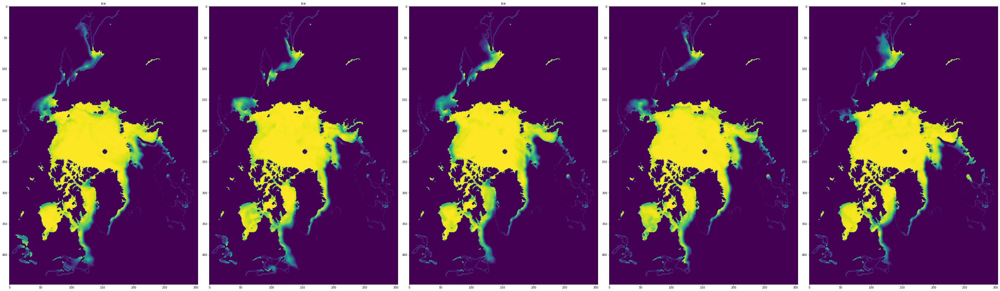

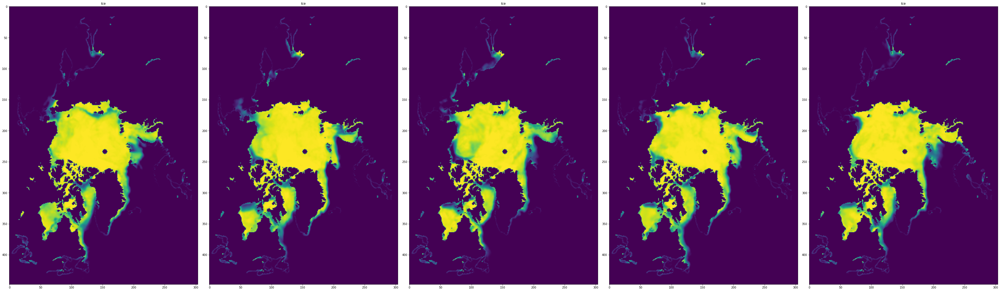

...

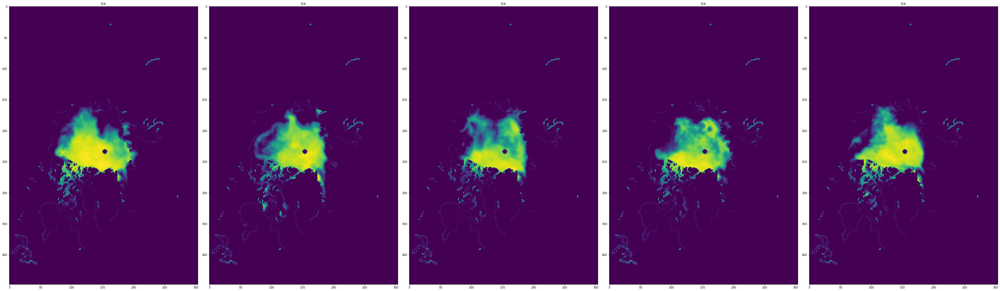

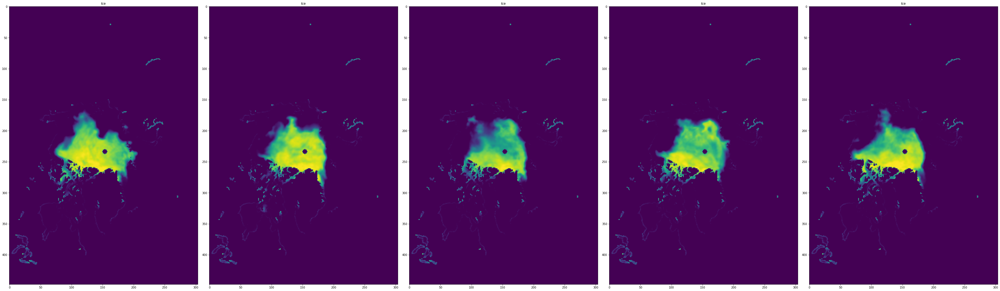

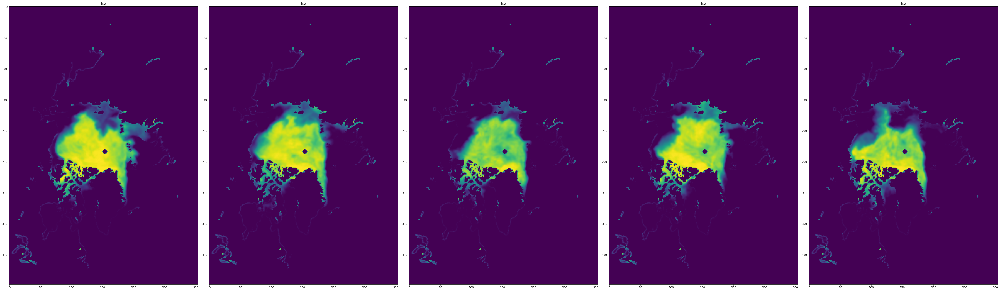

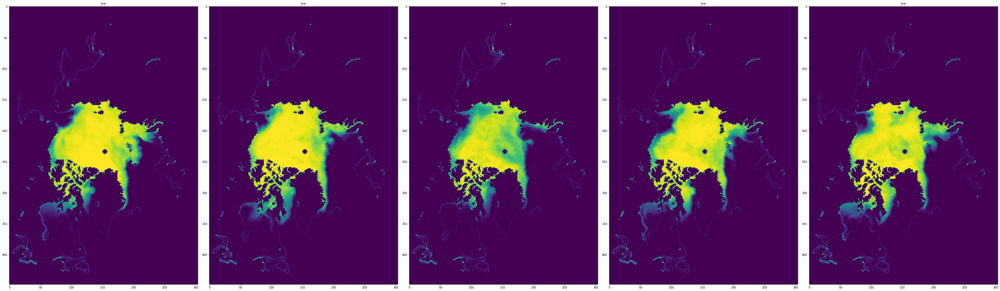

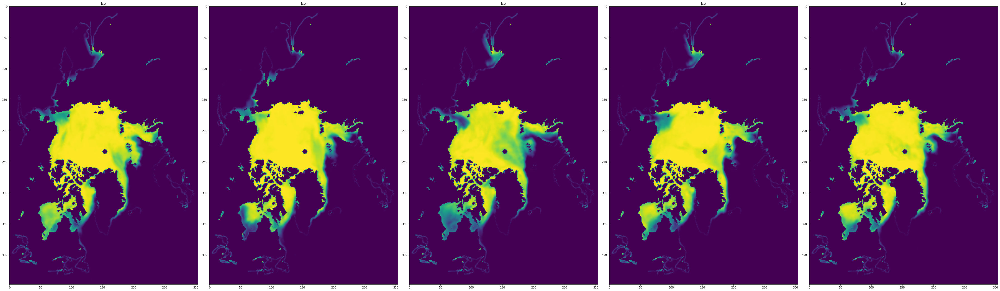

In [ ]:
# 월별 데이터 확인
for i in range(12):
  d = globals()['train{}'.format(i)]
  show(d)

In [ ]:
train0[:4].shape

(4, 448, 304)

In [ ]:
train0[4].reshape(1,448,304).shape

(1, 448, 304)

In [ ]:
# Model 생성
import torch
import torch.nn as nn
import torch.nn.functional as F

class LSTM(nn.Module):
    def __init__(self, input_size, hidden_size):
        super(LSTM, self).__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size

        self.lstm = nn.LSTM(input_size = hidden_size,
                            hidden_size = hidden_size,
                            batch_first=True,
                            num_layers = 1)
        self.relu = nn.ReLU(inplace = True)
        self.time_fc = nn.Linear(hidden_size, 304)
        
        self.f1 = nn.Linear(input_size, hidden_size)

    def forward(self, x_time):
        out_time = self.f1(x_time)
        out_time, _ = self.lstm(x_time)
        out_time = self.relu(out_time)
        out_time = self.time_fc(out_time[-1:,:,:])  # 나오는 수 아웃풋
        out_time = self.relu(out_time[-1:,:,:])
        
        return out_time.view(1,448,304)  # -1은 전체 나와라

# model = LSTM(input_size = 304, hidden_size = 304).to(device)

In [ ]:
# 데이터 셋
window_x = torch.tensor(train0[:4]).float().to(device)  # 데이터를 GPU로
window_y = torch.tensor(train0[4].reshape(1,448,304)).float().to(device)

In [ ]:
window_x.shape, window_y.shape

(torch.Size([4, 448, 304]), torch.Size([1, 448, 304]))

In [ ]:
# 함수

def aaa(number):

  a = globals()['train{}'.format(number)]
  
  print('train{}'.format(number))

  # 데이터 셋
  window_x = torch.tensor(a[:4]).float().to(device)  # 데이터를 GPU로  
  window_y = torch.tensor(a[4].reshape(1,448,304)).float().to(device)

  # 모델
  model_0 = LSTM(input_size = 304, hidden_size = 350).to(device)
  
  optimizer = torch.optim.Adam(model_0.parameters(), lr = 0.0008)  
  criterion = nn.MSELoss()
  num_epochs  = 5000
  train_error = []

  for t in range(num_epochs):
    train_pred = model_0(window_x)
    loss = criterion(train_pred, window_y)  
    train_error.append(loss)
    
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    if (t +1) % 500 == 0:
      print((t +1), "Epochs train MSE: ", loss.item())  

  # 예측
  a = model_0(window_y)
  pred = a.cpu().detach().numpy().reshape(448,304)
  
  globals()['a{}'.format(number)] = pred


In [ ]:
for i in range(12):
  aaa(i)

train0
500 Epochs train MSE:  255.6507110595703
1000 Epochs train MSE:  167.23532104492188
1500 Epochs train MSE:  154.80233764648438
2000 Epochs train MSE:  161.84788513183594
2500 Epochs train MSE:  104.30125427246094
3000 Epochs train MSE:  81.54136657714844
3500 Epochs train MSE:  72.8313980102539
4000 Epochs train MSE:  71.77114868164062
4500 Epochs train MSE:  71.4398193359375
5000 Epochs train MSE:  76.29712677001953
train1
500 Epochs train MSE:  392.60540771484375
1000 Epochs train MSE:  292.1097412109375
1500 Epochs train MSE:  278.1855163574219
2000 Epochs train MSE:  156.80093383789062
2500 Epochs train MSE:  106.29669189453125
3000 Epochs train MSE:  108.68118286132812
3500 Epochs train MSE:  101.20606994628906
4000 Epochs train MSE:  98.64781951904297
4500 Epochs train MSE:  99.47956848144531
5000 Epochs train MSE:  96.75468444824219
train2
500 Epochs train MSE:  329.0218200683594
1000 Epochs train MSE:  258.87261962890625
1500 Epochs train MSE:  245.15597534179688
2000 Ep

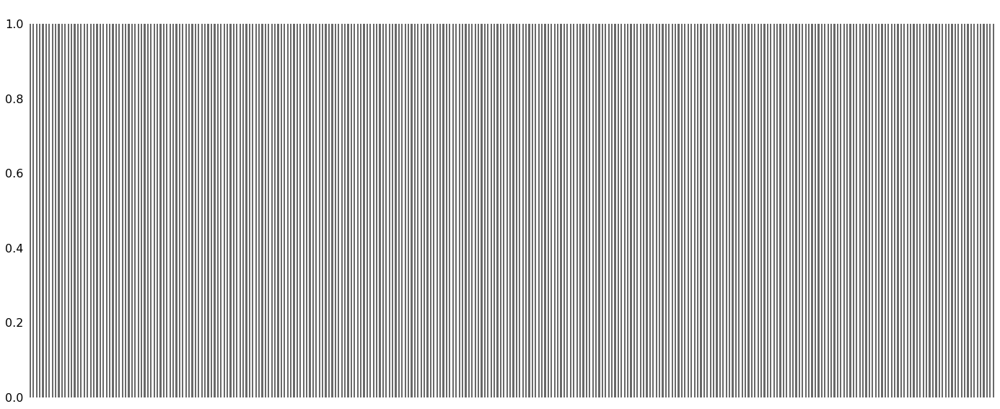

In [ ]:
import missingno as msno
msno.bar(pd.DataFrame(train8[2]))
# pd.DataFrame(train5[2]).isna().sum()

In [ ]:
pd.DataFrame(train8[4]).isnull().sum().sum()

0

In [ ]:
window_x = torch.tensor(train8[:4]).float().to(device)  # 데이터를 GPU로  
window_y = torch.tensor(train8[4].reshape(1,448,304)).float().to(device)
model_0(window_x)

tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]], device='cuda:0',
       grad_fn=<ViewBackward>)

In [ ]:
model_0(window_x).shape

torch.Size([1, 448, 304])

In [ ]:
pd.DataFrame(window_y).isnull().sum().sum()

0

In [ ]:
window_y.shape

torch.Size([1, 448, 304])

In [ ]:
criterion(model_0(window_x), window_y)  

tensor(1146.4137, device='cuda:0', grad_fn=<MseLossBackward>)

In [ ]:
d = pd.DataFrame(train8[0])
d.iloc[(d.isna() == True),:]

ValueError: ignored

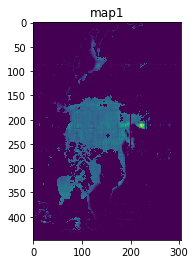

In [ ]:
# 그래프 그려보기
import matplotlib.pyplot
matplotlib.pyplot.imshow(a0, interpolation = 'None')
matplotlib.pyplot.title('map1')
matplotlib.pyplot.show()

In [ ]:
for i in range(12):
  print('a{}'.format(i))
  sh = globals()['a{}'.format(i)]
  print(sh.shape)

a0
(448, 304)
a1
(448, 304)
a2
(448, 304)
a3
(448, 304)
a4
(448, 304)
a5
(448, 304)
a6
(448, 304)
a7
(448, 304)
a8
(448, 304)
a9
(448, 304)
a10
(448, 304)
a11
(448, 304)


In [ ]:
a00 = a0.flatten()
a11 = a1.flatten()

In [ ]:
pd.concat((pd.DataFrame(a00), pd.DataFrame(a11)), axis=1).T

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,136152,136153,136154,136155,136156,136157,136158,136159,136160,136161,136162,136163,136164,136165,136166,136167,136168,136169,136170,136171,136172,136173,136174,136175,136176,136177,136178,136179,136180,136181,136182,136183,136184,136185,136186,136187,136188,136189,136190,136191
0,-0.300364,-0.469871,-2.143445,-0.515727,0.388646,-0.057219,-0.344755,-2.469652,-1.547591,-1.336731,-1.454313,-2.133392,-4.067870,-1.292614,-1.945988,0.228403,-0.918704,-1.228467,1.508693,1.320930,-4.475691,-3.897219,-3.467510,-1.570797,1.176086,0.126717,2.669886,4.065519,2.414455,-0.463134,-0.955287,-5.815211,-1.112633,-7.748525,-8.153834,-6.249945,-10.069598,-1.880501,-7.049236,-10.593591,...,-2.133783,-1.834732,-1.299625,-0.610541,-0.058325,-0.935063,-1.75778,-1.855718,-1.153989,-0.373968,-0.527775,-0.835108,-1.063236,-1.809215,-0.970658,-2.216591,-0.618166,0.952541,0.655663,1.509399,0.462717,-1.427857,-1.060632,-0.712059,-1.035424,-1.401209,-1.590456,0.610840,-0.939752,-1.031353,-1.047871,-1.121787,0.223013,-0.697139,0.332771,1.397938,-0.668162,-0.844768,0.560319,0.470689
0,0.068617,0.155661,-0.095869,0.239940,-1.847064,-0.956334,-0.374925,-0.738875,-0.639984,-0.614767,-0.175980,0.626868,3.377809,3.699929,4.338602,3.647567,6.894026,5.003918,4.516331,3.446965,7.549632,-3.514473,-1.024254,2.992162,3.933247,1.418562,1.261543,-2.930445,-5.458613,-2.514471,-0.822299,1.970531,1.724662,-2.557098,-1.843138,-3.412107,-4.921885,1.389740,0.217113,-0.070384,...,-7.253574,-5.662739,-10.283263,-10.932906,-1.835991,-0.580535,-1.54737,-2.580401,-3.713209,-4.164331,-5.813921,-3.454281,-4.091017,-0.443848,3.839122,8.453660,3.805371,8.075843,3.258349,-4.009621,-0.143315,-2.685625,-5.467536,-1.808994,2.440796,-2.395844,-2.164334,-4.459301,-2.587236,-0.686754,-2.733178,-5.733824,-4.589310,-2.444708,0.172628,-3.323351,2.530367,-3.032949,-1.955844,1.500200


In [ ]:
# 데이터 생성
sh1 = pd.DataFrame(a0.flatten())

for i in range(11):
  print('a{}'.format(i+1))
  sh = globals()['a{}'.format(i+1)]
  sh = sh.flatten()
  sh = pd.DataFrame(sh)

  sh1 = pd.concat((sh1, sh), axis=1)
  print(sh1.shape)

a1
(136192, 2)
a2
(136192, 3)
a3
(136192, 4)
a4
(136192, 5)
a5
(136192, 6)
a6
(136192, 7)
a7
(136192, 8)
a8
(136192, 9)
a9
(136192, 10)
a10
(136192, 11)
a11
(136192, 12)


In [ ]:
result = sh1.T
result = result.reset_index(drop=True)
result

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,136152,136153,136154,136155,136156,136157,136158,136159,136160,136161,136162,136163,136164,136165,136166,136167,136168,136169,136170,136171,136172,136173,136174,136175,136176,136177,136178,136179,136180,136181,136182,136183,136184,136185,136186,136187,136188,136189,136190,136191
0,0.000000,0.0,0.0,0.0,0.0,0.0,1.328297,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.00000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,2.480631,0.000000,0.0,0.0,0.000000,5.191974,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,2.958263,2.986322,4.345494,2.33271,0.0,9.348044,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,6.052172,0.0,0.0,4.685981,0.000000,0.0,0.000000,3.420078,13.120008,5.580409,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.986216,0.0,0.0,0.0,0.0,0.0,0.000000,1.182309,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,2.785742,0.00000,0.0,0.000000,0.0,4.804256,3.511555,1.476928,3.682239,14.191475,0.000000,0.0,0.0,0.000000,0.000000,0.0,5.661174,2.199153,0.000000,3.916764,0.000000,0.366822,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.012545,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.00000,0.0,0.000000,0.0,0.000000,0.076988,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.146547,0.000000,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.00000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.00000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.00000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000501,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.00000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0

In [ ]:
# 사실 필요 없움
# 두번 해야..
# 12개월, 24개월 투투
result1 = pd.concat([result,result], axis=0)
result1 = result1.reset_index(drop=True)

In [ ]:
submission = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/data/sample_submission.csv")
sub = pd.concat([submission.loc[:,'month'],result1], axis=1)
sub.columns = submission.columns.values  # 제출파일에서 컬럼명을 
sub.tail()

,month,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,...,136152,136153,136154,136155,136156,136157,136158,136159,136160,136161,136162,136163,136164,136165,136166,136167,136168,136169,136170,136171,136172,136173,136174,136175,136176,136177,136178,136179,136180,136181,136182,136183,136184,136185,136186,136187,136188,136189,136190,136191
19,2020-08,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
20,2020-09,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
21,2020-10,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
22,2020-11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
23,2020-12,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.029183,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
# 제출
sub.to_csv('/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/result/sub_0306-2.csv', index = False)

-----

일단 여기서 제출!!!

In [ ]:
data[0, 0,:,150]

array([  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   6,  28,  50,  12,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0, 177, 162,
       165, 187,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0, 234, 230,
       231, 233, 234, 236, 236, 237, 237, 237, 238, 240, 240, 243,   0,
         0,   0,   0,   0,   0, 232, 240, 246, 247, 247, 247, 24

In [ ]:
data.shape

(60, 1, 448, 304)

In [ ]:
model_0(window_x)[0,:,150]

tensor([0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+

In [ ]:
window_x.shape

torch.Size([4, 448, 304])

In [ ]:
window_x = torch.tensor(train8[:4]).float().to(device)  # 데이터를 GPU로  
window_y = torch.tensor(train8[4].reshape(1,448,304)).float().to(device)

In [ ]:
# 시험용 모델 실험1
model_0 = LSTM(input_size = 304, hidden_size = 304).to(device)
model_0(window_x)

tensor([[[0.0127, 0.0000, 0.0000,  ..., 0.0000, 0.0366, 0.0437],
         [0.0127, 0.0000, 0.0000,  ..., 0.0000, 0.0366, 0.0437],
         [0.0127, 0.0000, 0.0000,  ..., 0.0000, 0.0366, 0.0437],
         ...,
         [0.0127, 0.0000, 0.0000,  ..., 0.0000, 0.0366, 0.0437],
         [0.0127, 0.0000, 0.0000,  ..., 0.0000, 0.0366, 0.0437],
         [0.0127, 0.0000, 0.0000,  ..., 0.0000, 0.0366, 0.0437]]],
       device='cuda:0', grad_fn=<ViewBackward>)

In [ ]:
model_0(window_x).shape

torch.Size([1, 448, 304])

In [ ]:
# 시험용 모델 생성
# Model 생성
import torch
import torch.nn as nn
import torch.nn.functional as F

class LSTM(nn.Module):
    def __init__(self, input_size, hidden_size):
        super(LSTM, self).__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size

        self.l1 = nn.Linear(input_size, hidden_size)
        self.l2 = nn.Linear(hidden_size, hidden_size)
        self.l3 = nn.Linear(hidden_size, hidden_size)
        # self.l4 = nn.Linear(hidden_size, hidden_size)
        self.l5 = nn.Linear(hidden_size, 304)
        self.relu = nn.ReLU(inplace = True)
        
        self.f1 = nn.Linear(input_size, hidden_size)

    def forward(self, x_time):
      
        out_time = self.l1(x_time)
        out_time = self.l2(out_time)  # 나오는 수 아웃풋
        out_time = self.l3(out_time)
        # out_time = self.l4(out_time)
        out_time = self.l5(out_time)
        out_time = self.relu(out_time[-1:,:,:])
        
        return out_time.view(1,448,304)  # -1은 전체 나와라

# model = LSTM(input_size = 304, hidden_size = 304).to(device)

In [ ]:
# 가장 완벽한 러닝 레이트를 찾아
from random import *
a = [0.0009, 0.00085, 0.0008, 0.00075, 0.0007, 0.0006, 0.0005, 0.0004, 0.0003]

for i in range(len(a)):
  lr = a[i]
  print("\n",a[i])
  model_0 = LSTM(input_size = 304, hidden_size = 350).to(device)
  
  optimizer = torch.optim.Adam(model_0.parameters(), lr = lr)  
  criterion = nn.MSELoss()
  num_epochs  = 5000
  train_error = []

  for t in range(num_epochs):
    train_pred = model_0(window_x)
    loss = criterion(train_pred, window_y)  
    train_error.append(loss)
    
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    if (t +1) % 500 == 0:
      print((t +1), "Epochs train MSE: ", loss.item())


 0.0009
500 Epochs train MSE:  20.52220916748047
1000 Epochs train MSE:  14.256443977355957
1500 Epochs train MSE:  10.125039100646973
2000 Epochs train MSE:  7.446448802947998
2500 Epochs train MSE:  6.692957401275635
3000 Epochs train MSE:  5.538405418395996
3500 Epochs train MSE:  5.222711563110352
4000 Epochs train MSE:  5.780550956726074
4500 Epochs train MSE:  4.462229251861572
5000 Epochs train MSE:  4.867791175842285

 0.00085
500 Epochs train MSE:  17.707035064697266
1000 Epochs train MSE:  9.868545532226562
1500 Epochs train MSE:  7.611878871917725
2000 Epochs train MSE:  6.628190517425537
2500 Epochs train MSE:  6.343435764312744
3000 Epochs train MSE:  6.192171096801758
3500 Epochs train MSE:  6.381645679473877
4000 Epochs train MSE:  7.914741039276123
4500 Epochs train MSE:  4.853823661804199
5000 Epochs train MSE:  4.836268424987793

 0.0008
500 Epochs train MSE:  17.60721778869629
1000 Epochs train MSE:  11.799741744995117
1500 Epochs train MSE:  8.889917373657227
2000 

In [ ]:
a = model_0(window_y)

pred = a.cpu().detach().numpy().reshape(448,304)
pred.shape

(448, 304)

In [ ]:
# 파일 만들기
a = model_0(window_y)
pred = a.cpu().detach().numpy().reshape(448,304)
a1 = pred

In [ ]:
a1
a2
a3
a4
a5
a6
a7
a8
a9
a10
a11
a12

(448, 304)

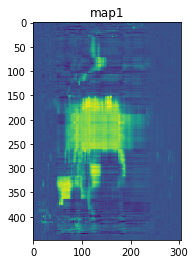

In [ ]:
# 그래프 그려보기
# 이게 예측 그림
import matplotlib.pyplot
matplotlib.pyplot.imshow(pred, interpolation = 'None')
matplotlib.pyplot.title('map1')
matplotlib.pyplot.show()

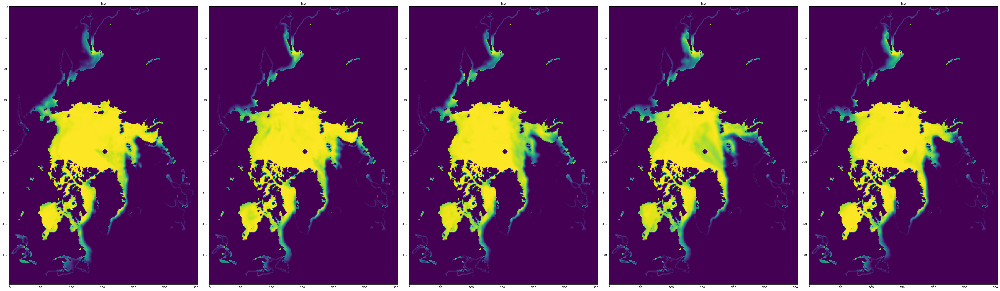

In [ ]:
# 이게 원본
show(train0)

In [ ]:
# 파이토치 라이브러리 임포트
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings(action='ignore')
import torch
import torch.nn as nn
import torch.nn.functional as F

import torchvision
import torchvision.transforms as transforms
from torch.utils.data import Dataset,DataLoader, TensorDataset
from torch.autograd import Variable  # 자동미분기능 제공
import torch.optim as optim
import matplotlib.pyplot as plt

from tqdm import tqdm  # 진행표시바

# np.random.seed(777)
# torch.manual_seed(777)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")  # GPU, CPU 선택
print('CPU? GPU? : ', device)

CPU? GPU? :  cuda:0


In [ ]:
# 구글드라이브 연결
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
fn = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/data/train.csv')
fn

,month,file_nm
0,1978-11,197811.npy
1,1978-12,197812.npy
2,1979-01,197901.npy
3,1979-02,197902.npy
4,1979-03,197903.npy
...,...,...
477,2018-08,201808.npy
478,2018-09,201809.npy
479,2018-10,201810.npy
480,2018-11,201811.npy


데이터 생성

In [ ]:
# 이거는 데이터명만
# 첫 번째 파일은 제하고
dm = fn.iloc[423:,1]
dm.shape

(59,)

In [ ]:
# 데이터 확인
data = np.load('/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/data/train/201401.npy')

In [ ]:
data[:,150,0]

array([  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   6,  28,  50,  12,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0, 177, 162,
       165, 187,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0, 234, 230,
       231, 233, 234, 236, 236, 237, 237, 237, 238, 240, 240, 243,   0,
         0,   0,   0,   0,   0, 232, 240, 246, 247, 247, 247, 24

In [ ]:
# 데이터 생성
data = np.load('/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/data/train/201401.npy')
data = data.reshape(1,448,304,5)

for i in tqdm(dm):
    a = np.load('/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/data/train/'+i)
    a = a.reshape(1,448,304,5)

    data = np.concatenate((data,a), axis=0)
data = np.array(data)
data = data[:,:,:,0]

data.shape

100%|██████████| 59/59 [00:22<00:00,  2.61it/s]


(60, 448, 304)

그냥

In [ ]:
data.shape[0]

60

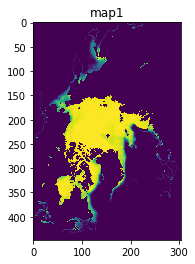

In [ ]:
# 그래프 그려보기
import matplotlib.pyplot
matplotlib.pyplot.imshow(data[0], interpolation = 'None')
matplotlib.pyplot.title('map1')
matplotlib.pyplot.show()

그냥 끝

In [ ]:
# 그래프 함수
def show(npy):
    num_channel = npy.shape[0]
    plt.figure(figsize=(50, 50)) 
    for channel in range(num_channel):
      tmpimg = npy[channel, :, :]
      ax = plt.subplot(1, num_channel, channel+1)  # (행, 열, 데이터 개수) - 그리고 싶은 팜플렛
      ax.title.set_text("Ice")

      ax.imshow(tmpimg)
    plt.tight_layout()
    plt.show()
    plt.close()

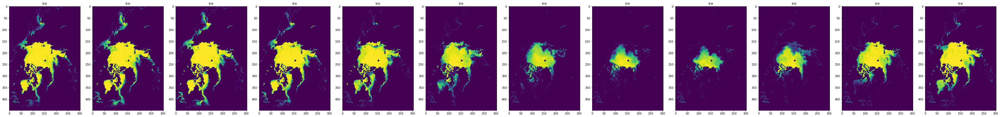

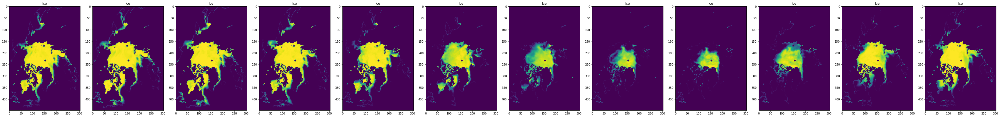

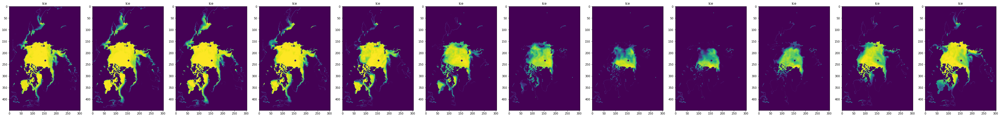

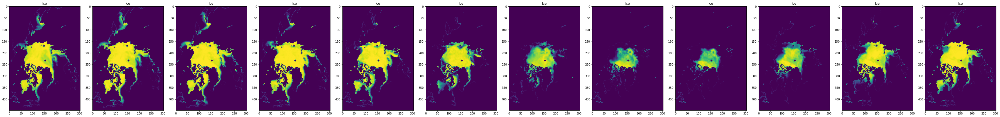

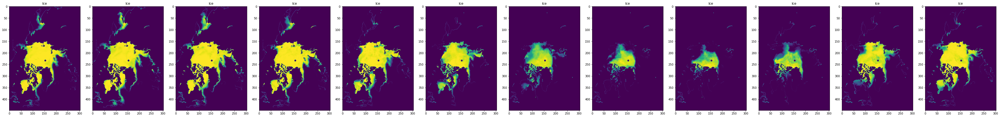

In [ ]:
show(data[:12])
show(data[12:24])
show(data[24:36])
show(data[36:48])
show(data[48:60])

In [ ]:
# 데이터 셋 만들기

# 데이터 셋 형태 변환
data = data.reshape(60,1, 448,304)

# 월별로 데이터 셋 생성
for i in tqdm(range(12)):
  globals()['train{}'.format(i)] = np.array(np.concatenate((data[0+i], data[12+i], data[24+i], data[36+i], data[48+i]), axis=0))

  print("\n",globals()['train{}'.format(i)].shape)  # globals()는 그 변수를 의미 - 없으면 그냥 문자열

100%|██████████| 12/12 [00:00<00:00, 743.80it/s]


 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)

 (5, 448, 304)


월별로 5개씩(5년)

총 12개의 데이터 (12개월)

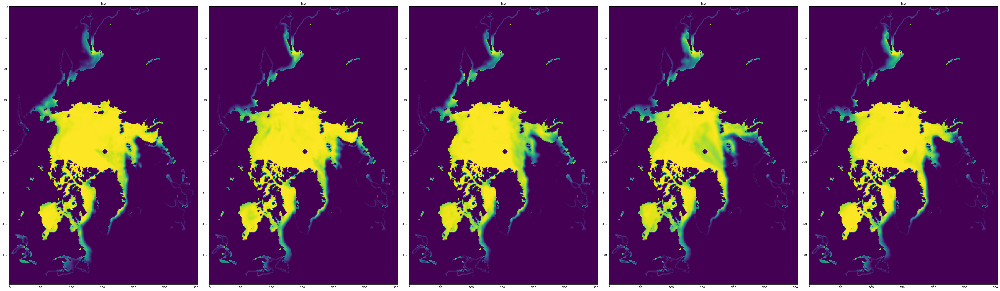

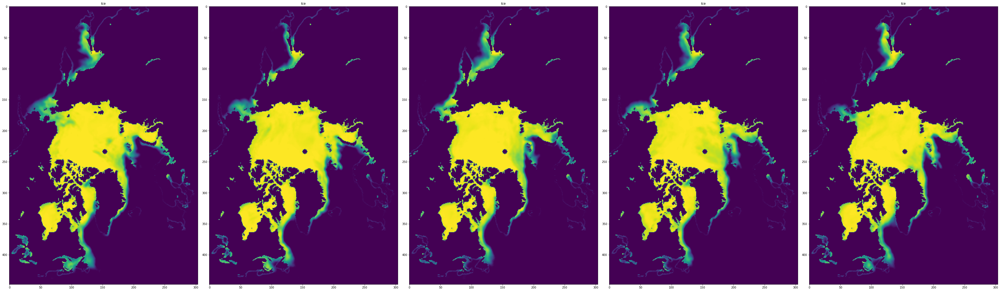

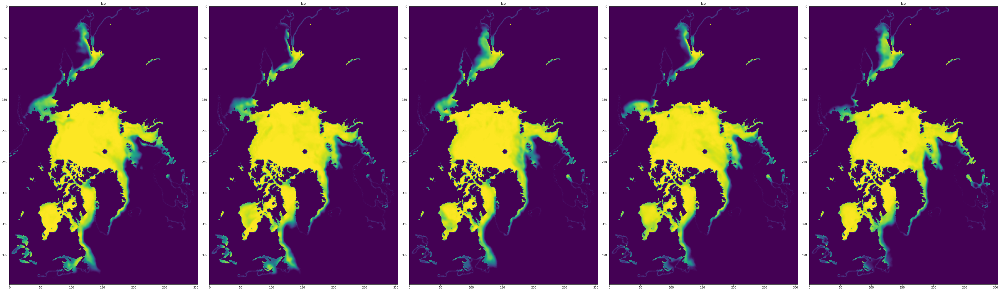

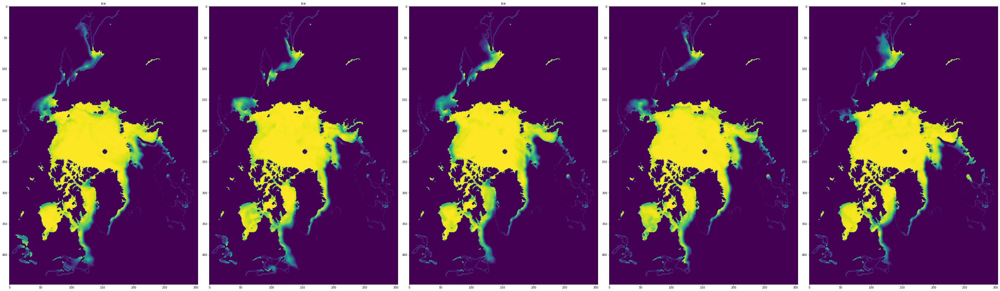

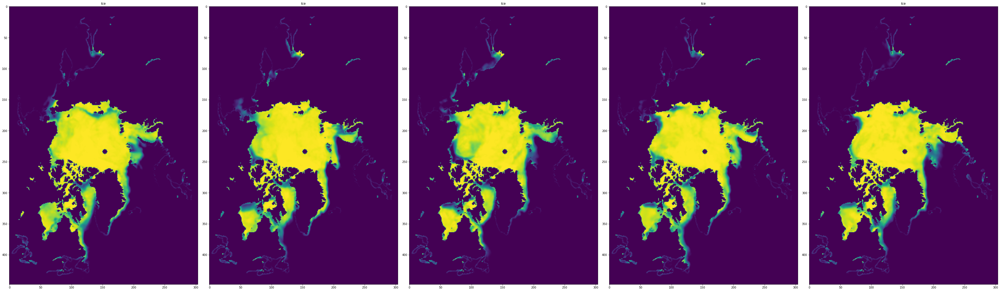

...

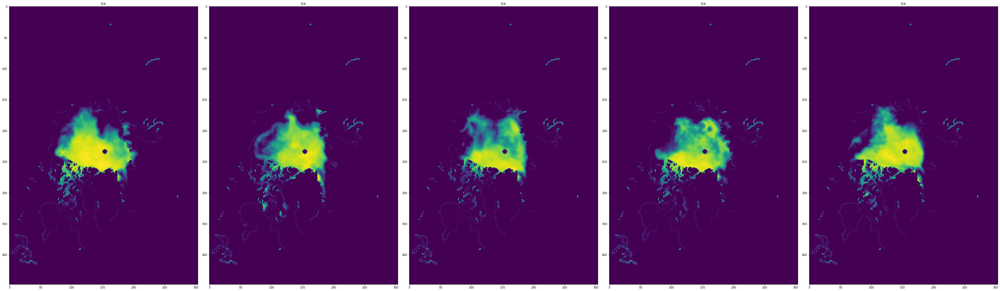

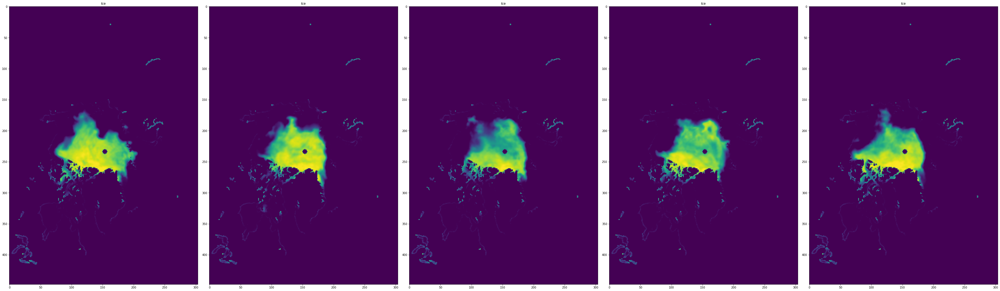

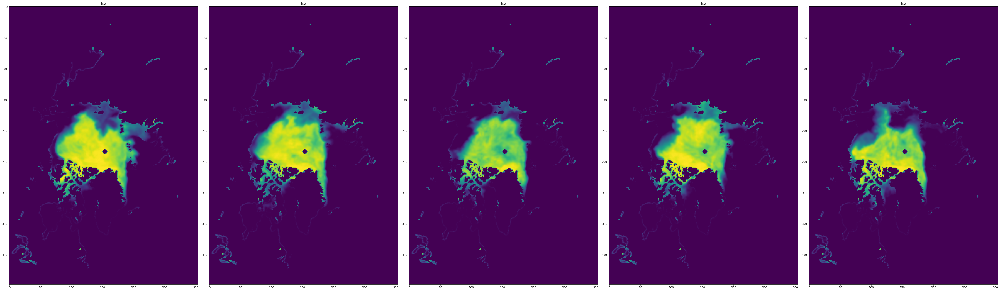

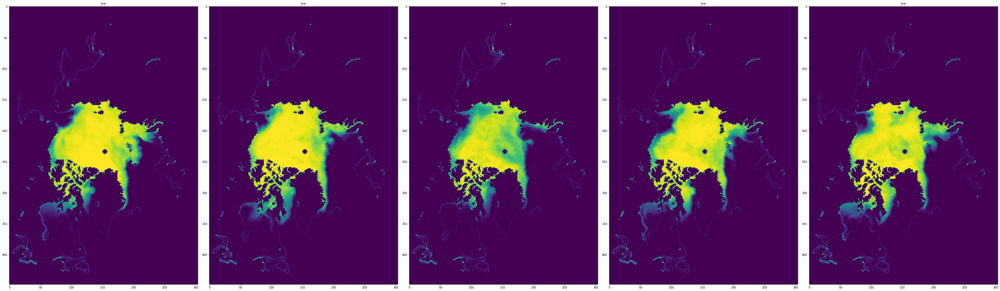

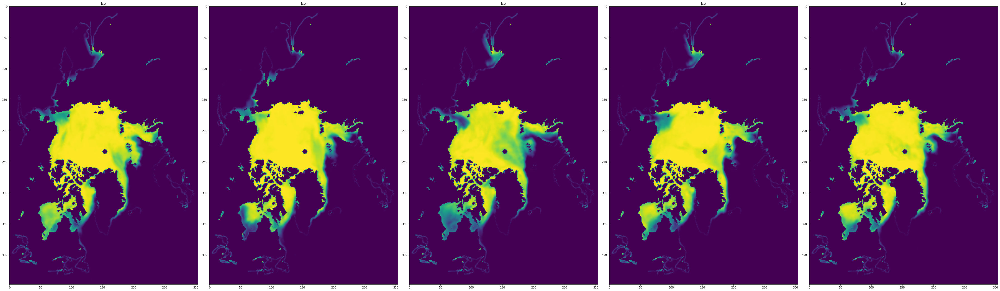

In [ ]:
# 월별 데이터 확인
for i in range(12):
  d = globals()['train{}'.format(i)]
  show(d)

In [ ]:
train0[:4].shape

(4, 448, 304)

In [ ]:
train0[4].reshape(1,448,304).shape

(1, 448, 304)

In [ ]:
# Model 생성
import torch
import torch.nn as nn
import torch.nn.functional as F

class LSTM(nn.Module):
    def __init__(self, input_size, hidden_size):
        super(LSTM, self).__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size

        self.lstm = nn.LSTM(input_size = hidden_size,
                            hidden_size = hidden_size,
                            batch_first=True,
                            num_layers = 1)
        self.relu = nn.ReLU(inplace = True)
        self.time_fc = nn.Linear(hidden_size, 304)
        
        self.f1 = nn.Linear(input_size, hidden_size)

    def forward(self, x_time):
        out_time = self.f1(x_time)
        out_time, _ = self.lstm(x_time)
        out_time = self.relu(out_time)
        out_time = self.time_fc(out_time[-1:,:,:])  # 나오는 수 아웃풋
        out_time = self.relu(out_time[-1:,:,:])
        
        return out_time.view(1,448,304)  # -1은 전체 나와라

# model = LSTM(input_size = 304, hidden_size = 304).to(device)

In [ ]:
# 데이터 셋
window_x = torch.tensor(train0[:4]).float().to(device)  # 데이터를 GPU로
window_y = torch.tensor(train0[4].reshape(1,448,304)).float().to(device)

In [ ]:
window_x.shape, window_y.shape

(torch.Size([4, 448, 304]), torch.Size([1, 448, 304]))

In [ ]:
# 함수

def aaa(number):

  a = globals()['train{}'.format(number)]
  
  print('train{}'.format(number))

  # 데이터 셋
  window_x = torch.tensor(a[:4]).float().to(device)  # 데이터를 GPU로  
  window_y = torch.tensor(a[4].reshape(1,448,304)).float().to(device)

  # 모델
  model_0 = LSTM(input_size = 304, hidden_size = 350).to(device)
  
  optimizer = torch.optim.Adam(model_0.parameters(), lr = 0.0008)  
  criterion = nn.MSELoss()
  num_epochs  = 5000
  train_error = []

  for t in range(num_epochs):
    train_pred = model_0(window_x)
    loss = criterion(train_pred, window_y)  
    train_error.append(loss)
    
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    if (t +1) % 500 == 0:
      print((t +1), "Epochs train MSE: ", loss.item())  

  # 예측
  a = model_0(window_y)
  pred = a.cpu().detach().numpy().reshape(448,304)
  
  globals()['a{}'.format(number)] = pred


In [ ]:
for i in range(12):
  aaa(i)

train0
500 Epochs train MSE:  255.6507110595703
1000 Epochs train MSE:  167.23532104492188
1500 Epochs train MSE:  154.80233764648438
2000 Epochs train MSE:  161.84788513183594
2500 Epochs train MSE:  104.30125427246094
3000 Epochs train MSE:  81.54136657714844
3500 Epochs train MSE:  72.8313980102539
4000 Epochs train MSE:  71.77114868164062
4500 Epochs train MSE:  71.4398193359375
5000 Epochs train MSE:  76.29712677001953
train1
500 Epochs train MSE:  392.60540771484375
1000 Epochs train MSE:  292.1097412109375
1500 Epochs train MSE:  278.1855163574219
2000 Epochs train MSE:  156.80093383789062
2500 Epochs train MSE:  106.29669189453125
3000 Epochs train MSE:  108.68118286132812
3500 Epochs train MSE:  101.20606994628906
4000 Epochs train MSE:  98.64781951904297
4500 Epochs train MSE:  99.47956848144531
5000 Epochs train MSE:  96.75468444824219
train2
500 Epochs train MSE:  329.0218200683594
1000 Epochs train MSE:  258.87261962890625
1500 Epochs train MSE:  245.15597534179688
2000 Ep

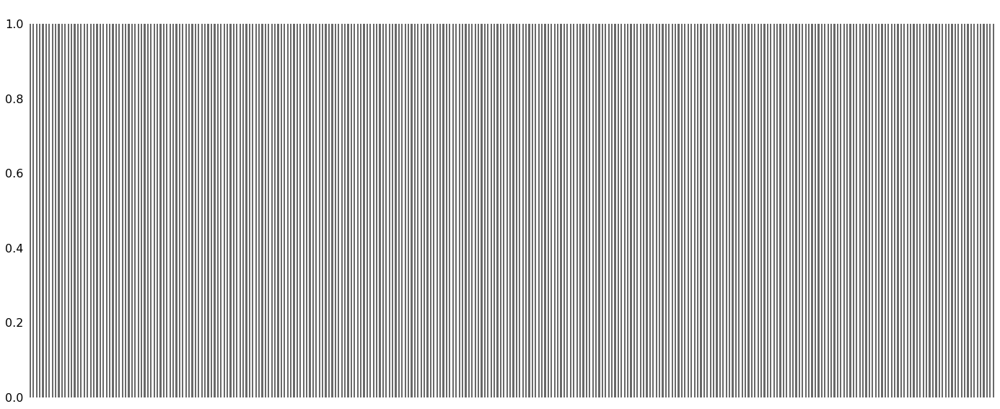

In [ ]:
import missingno as msno
msno.bar(pd.DataFrame(train8[2]))
# pd.DataFrame(train5[2]).isna().sum()

In [ ]:
pd.DataFrame(train8[4]).isnull().sum().sum()

0

In [ ]:
window_x = torch.tensor(train8[:4]).float().to(device)  # 데이터를 GPU로  
window_y = torch.tensor(train8[4].reshape(1,448,304)).float().to(device)
model_0(window_x)

tensor([[[0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         ...,
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.],
         [0., 0., 0.,  ..., 0., 0., 0.]]], device='cuda:0',
       grad_fn=<ViewBackward>)

In [ ]:
model_0(window_x).shape

torch.Size([1, 448, 304])

In [ ]:
pd.DataFrame(window_y).isnull().sum().sum()

0

In [ ]:
window_y.shape

torch.Size([1, 448, 304])

In [ ]:
criterion(model_0(window_x), window_y)  

tensor(1146.4137, device='cuda:0', grad_fn=<MseLossBackward>)

In [ ]:
d = pd.DataFrame(train8[0])
d.iloc[(d.isna() == True),:]

ValueError: ignored

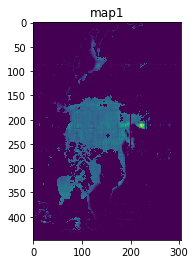

In [ ]:
# 그래프 그려보기
import matplotlib.pyplot
matplotlib.pyplot.imshow(a0, interpolation = 'None')
matplotlib.pyplot.title('map1')
matplotlib.pyplot.show()

In [ ]:
for i in range(12):
  print('a{}'.format(i))
  sh = globals()['a{}'.format(i)]
  print(sh.shape)

a0
(448, 304)
a1
(448, 304)
a2
(448, 304)
a3
(448, 304)
a4
(448, 304)
a5
(448, 304)
a6
(448, 304)
a7
(448, 304)
a8
(448, 304)
a9
(448, 304)
a10
(448, 304)
a11
(448, 304)


In [ ]:
a00 = a0.flatten()
a11 = a1.flatten()

In [ ]:
pd.concat((pd.DataFrame(a00), pd.DataFrame(a11)), axis=1).T

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,136152,136153,136154,136155,136156,136157,136158,136159,136160,136161,136162,136163,136164,136165,136166,136167,136168,136169,136170,136171,136172,136173,136174,136175,136176,136177,136178,136179,136180,136181,136182,136183,136184,136185,136186,136187,136188,136189,136190,136191
0,-0.300364,-0.469871,-2.143445,-0.515727,0.388646,-0.057219,-0.344755,-2.469652,-1.547591,-1.336731,-1.454313,-2.133392,-4.067870,-1.292614,-1.945988,0.228403,-0.918704,-1.228467,1.508693,1.320930,-4.475691,-3.897219,-3.467510,-1.570797,1.176086,0.126717,2.669886,4.065519,2.414455,-0.463134,-0.955287,-5.815211,-1.112633,-7.748525,-8.153834,-6.249945,-10.069598,-1.880501,-7.049236,-10.593591,...,-2.133783,-1.834732,-1.299625,-0.610541,-0.058325,-0.935063,-1.75778,-1.855718,-1.153989,-0.373968,-0.527775,-0.835108,-1.063236,-1.809215,-0.970658,-2.216591,-0.618166,0.952541,0.655663,1.509399,0.462717,-1.427857,-1.060632,-0.712059,-1.035424,-1.401209,-1.590456,0.610840,-0.939752,-1.031353,-1.047871,-1.121787,0.223013,-0.697139,0.332771,1.397938,-0.668162,-0.844768,0.560319,0.470689
0,0.068617,0.155661,-0.095869,0.239940,-1.847064,-0.956334,-0.374925,-0.738875,-0.639984,-0.614767,-0.175980,0.626868,3.377809,3.699929,4.338602,3.647567,6.894026,5.003918,4.516331,3.446965,7.549632,-3.514473,-1.024254,2.992162,3.933247,1.418562,1.261543,-2.930445,-5.458613,-2.514471,-0.822299,1.970531,1.724662,-2.557098,-1.843138,-3.412107,-4.921885,1.389740,0.217113,-0.070384,...,-7.253574,-5.662739,-10.283263,-10.932906,-1.835991,-0.580535,-1.54737,-2.580401,-3.713209,-4.164331,-5.813921,-3.454281,-4.091017,-0.443848,3.839122,8.453660,3.805371,8.075843,3.258349,-4.009621,-0.143315,-2.685625,-5.467536,-1.808994,2.440796,-2.395844,-2.164334,-4.459301,-2.587236,-0.686754,-2.733178,-5.733824,-4.589310,-2.444708,0.172628,-3.323351,2.530367,-3.032949,-1.955844,1.500200


In [ ]:
# 데이터 생성
sh1 = pd.DataFrame(a0.flatten())

for i in range(11):
  print('a{}'.format(i+1))
  sh = globals()['a{}'.format(i+1)]
  sh = sh.flatten()
  sh = pd.DataFrame(sh)

  sh1 = pd.concat((sh1, sh), axis=1)
  print(sh1.shape)

a1
(136192, 2)
a2
(136192, 3)
a3
(136192, 4)
a4
(136192, 5)
a5
(136192, 6)
a6
(136192, 7)
a7
(136192, 8)
a8
(136192, 9)
a9
(136192, 10)
a10
(136192, 11)
a11
(136192, 12)


In [ ]:
result = sh1.T
result = result.reset_index(drop=True)
result

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,136152,136153,136154,136155,136156,136157,136158,136159,136160,136161,136162,136163,136164,136165,136166,136167,136168,136169,136170,136171,136172,136173,136174,136175,136176,136177,136178,136179,136180,136181,136182,136183,136184,136185,136186,136187,136188,136189,136190,136191
0,0.000000,0.0,0.0,0.0,0.0,0.0,1.328297,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.00000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,2.480631,0.000000,0.0,0.0,0.000000,5.191974,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,2.958263,2.986322,4.345494,2.33271,0.0,9.348044,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,6.052172,0.0,0.0,4.685981,0.000000,0.0,0.000000,3.420078,13.120008,5.580409,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.986216,0.0,0.0,0.0,0.0,0.0,0.000000,1.182309,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,2.785742,0.00000,0.0,0.000000,0.0,4.804256,3.511555,1.476928,3.682239,14.191475,0.000000,0.0,0.0,0.000000,0.000000,0.0,5.661174,2.199153,0.000000,3.916764,0.000000,0.366822,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.012545,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.00000,0.0,0.000000,0.0,0.000000,0.076988,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.146547,0.000000,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.00000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.00000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.00000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000501,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000,0.00000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0

In [ ]:
# 사실 필요 없움
# 두번 해야..
# 12개월, 24개월 투투
result1 = pd.concat([result,result], axis=0)
result1 = result1.reset_index(drop=True)

In [ ]:
submission = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/data/sample_submission.csv")
sub = pd.concat([submission.loc[:,'month'],result1], axis=1)
sub.columns = submission.columns.values  # 제출파일에서 컬럼명을 
sub.tail()

,month,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,...,136152,136153,136154,136155,136156,136157,136158,136159,136160,136161,136162,136163,136164,136165,136166,136167,136168,136169,136170,136171,136172,136173,136174,136175,136176,136177,136178,136179,136180,136181,136182,136183,136184,136185,136186,136187,136188,136189,136190,136191
19,2020-08,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
20,2020-09,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
21,2020-10,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
22,2020-11,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
23,2020-12,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.029183,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
# 제출
sub.to_csv('/content/drive/MyDrive/Colab Notebooks/DACON 1등이 목표/result/sub_0306-2.csv', index = False)

-----

일단 여기서 제출!!!

# 모델 시험

In [ ]:
data[0, 0,:,150]

array([  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   6,  28,  50,  12,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0, 177, 162,
       165, 187,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
         0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0, 234, 230,
       231, 233, 234, 236, 236, 237, 237, 237, 238, 240, 240, 243,   0,
         0,   0,   0,   0,   0, 232, 240, 246, 247, 247, 247, 24

In [ ]:
data.shape

(60, 1, 448, 304)

In [ ]:
model_0(window_x)[0,:,150]

tensor([0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00, 0.0000e+00,
        0.0000e+00, 0.0000e+00, 0.0000e+

In [ ]:
window_x.shape

torch.Size([4, 448, 304])

In [ ]:
window_x = torch.tensor(train8[:4]).float().to(device)  # 데이터를 GPU로  
window_y = torch.tensor(train8[4].reshape(1,448,304)).float().to(device)

In [ ]:
# 시험용 모델 실험1
model_0 = LSTM(input_size = 304, hidden_size = 304).to(device)
model_0(window_x)

tensor([[[0.0127, 0.0000, 0.0000,  ..., 0.0000, 0.0366, 0.0437],
         [0.0127, 0.0000, 0.0000,  ..., 0.0000, 0.0366, 0.0437],
         [0.0127, 0.0000, 0.0000,  ..., 0.0000, 0.0366, 0.0437],
         ...,
         [0.0127, 0.0000, 0.0000,  ..., 0.0000, 0.0366, 0.0437],
         [0.0127, 0.0000, 0.0000,  ..., 0.0000, 0.0366, 0.0437],
         [0.0127, 0.0000, 0.0000,  ..., 0.0000, 0.0366, 0.0437]]],
       device='cuda:0', grad_fn=<ViewBackward>)

In [ ]:
model_0(window_x).shape

torch.Size([1, 448, 304])

In [ ]:
# 시험용 모델 생성
# Model 생성
import torch
import torch.nn as nn
import torch.nn.functional as F

class LSTM(nn.Module):
    def __init__(self, input_size, hidden_size):
        super(LSTM, self).__init__()
        self.input_size = input_size
        self.hidden_size = hidden_size

        self.l1 = nn.Linear(input_size, hidden_size)
        self.l2 = nn.Linear(hidden_size, hidden_size)
        self.l3 = nn.Linear(hidden_size, hidden_size)
        # self.l4 = nn.Linear(hidden_size, hidden_size)
        self.l5 = nn.Linear(hidden_size, 304)
        self.relu = nn.ReLU(inplace = True)
        
        self.f1 = nn.Linear(input_size, hidden_size)

    def forward(self, x_time):
      
        out_time = self.l1(x_time)
        out_time = self.l2(out_time)  # 나오는 수 아웃풋
        out_time = self.l3(out_time)
        # out_time = self.l4(out_time)
        out_time = self.l5(out_time)
        out_time = self.relu(out_time[-1:,:,:])
        
        return out_time.view(1,448,304)  # -1은 전체 나와라

# model = LSTM(input_size = 304, hidden_size = 304).to(device)

In [ ]:
# 가장 완벽한 러닝 레이트를 찾아
from random import *
a = [0.0009, 0.00085, 0.0008, 0.00075, 0.0007, 0.0006, 0.0005, 0.0004, 0.0003]

for i in range(len(a)):
  lr = a[i]
  print("\n",a[i])
  model_0 = LSTM(input_size = 304, hidden_size = 350).to(device)
  
  optimizer = torch.optim.Adam(model_0.parameters(), lr = lr)  
  criterion = nn.MSELoss()
  num_epochs  = 5000
  train_error = []

  for t in range(num_epochs):
    train_pred = model_0(window_x)
    loss = criterion(train_pred, window_y)  
    train_error.append(loss)
    
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    if (t +1) % 500 == 0:
      print((t +1), "Epochs train MSE: ", loss.item())


 0.0009
500 Epochs train MSE:  20.52220916748047
1000 Epochs train MSE:  14.256443977355957
1500 Epochs train MSE:  10.125039100646973
2000 Epochs train MSE:  7.446448802947998
2500 Epochs train MSE:  6.692957401275635
3000 Epochs train MSE:  5.538405418395996
3500 Epochs train MSE:  5.222711563110352
4000 Epochs train MSE:  5.780550956726074
4500 Epochs train MSE:  4.462229251861572
5000 Epochs train MSE:  4.867791175842285

 0.00085
500 Epochs train MSE:  17.707035064697266
1000 Epochs train MSE:  9.868545532226562
1500 Epochs train MSE:  7.611878871917725
2000 Epochs train MSE:  6.628190517425537
2500 Epochs train MSE:  6.343435764312744
3000 Epochs train MSE:  6.192171096801758
3500 Epochs train MSE:  6.381645679473877
4000 Epochs train MSE:  7.914741039276123
4500 Epochs train MSE:  4.853823661804199
5000 Epochs train MSE:  4.836268424987793

 0.0008
500 Epochs train MSE:  17.60721778869629
1000 Epochs train MSE:  11.799741744995117
1500 Epochs train MSE:  8.889917373657227
2000 

In [ ]:
a = model_0(window_y)

pred = a.cpu().detach().numpy().reshape(448,304)
pred.shape

(448, 304)

In [ ]:
# 파일 만들기
a = model_0(window_y)
pred = a.cpu().detach().numpy().reshape(448,304)
a1 = pred

In [ ]:
a1
a2
a3
a4
a5
a6
a7
a8
a9
a10
a11
a12

(448, 304)

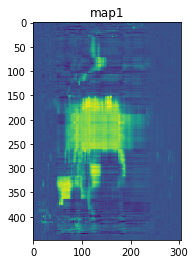

In [ ]:
# 그래프 그려보기
# 이게 예측 그림
import matplotlib.pyplot
matplotlib.pyplot.imshow(pred, interpolation = 'None')
matplotlib.pyplot.title('map1')
matplotlib.pyplot.show()

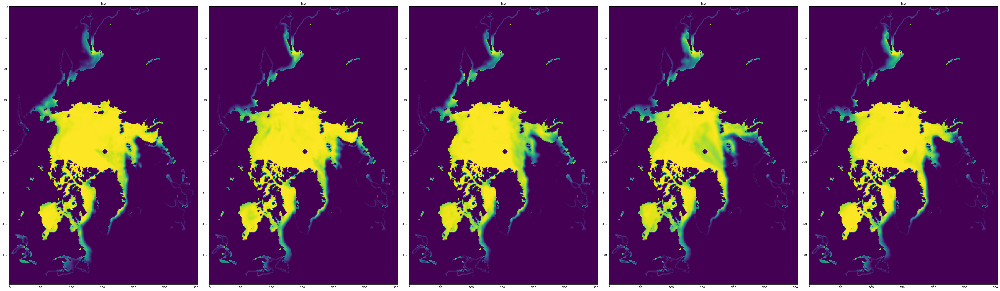

In [ ]:
# 이게 원본
show(train0)